#Entradas de extranjeros a Colombia
William Andres Talero Bermudez
Juan Sebastian Velasquez Castañda

#Importar librerias

In [1]:
import pandas as pd
import numpy as np
pd.set_option('display.max_columns', None) #Mostrar todas las columnas
import seaborn as sns
import matplotlib as plt
import matplotlib.pyplot as plt
import altair as alt
from vega_datasets import data

In [2]:
sns.set(rc={'figure.figsize':(12,8)})
pd.set_option('display.float_format', lambda x: '%.3f' % x)

#Cargar base

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
df_extranjeros = pd.read_csv('/content/drive/MyDrive/Base_Proyecto/df_extranjeros_2.csv', 
                 sep = ',',
                 thousands=',', decimal='.',
                 skip_blank_lines=True,
                 low_memory = False)
df_extranjeros

,Unnamed: 0,Año,Mes,Nacionalidad,Codigo Iso 3166,Femenino,Masculino,Indefinido,Total,Latitud - Longitud,Ciudad,Continente,Latitud,Longitud,Mes#,Año#,Fecha
0,0,2012,Enero,Islas Alboran y Perejil,99999,1,0,NaN,1,"(4.697144,-74.140516)",Bogotá,EUROPA,4.697144,-74.140516,1,2012,2012-01-01
1,1,2012,Enero,Albania,8,1,2,NaN,3,"(4.697144,-74.140516)",Bogotá,EUROPA,4.697144,-74.140516,1,2012,2012-01-01
2,2,2012,Enero,Alemania,276,11,16,NaN,27,"(-4.197703,-69.941278)",Leticia,EUROPA,-4.197703,-69.941278,1,2012,2012-01-01
3,3,2012,Enero,Alemania,276,1,1,NaN,2,"(0.25129,-76.875963)",Pasto,EUROPA,0.25129,-76.875963,1,2012,2012-01-01
4,4,2012,Enero,Alemania,276,63,102,NaN,165,"(0.814836,-77.662532)",Pasto,EUROPA,0.814836,-77.662532,1,2012,2012-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112288,112288,2021,Diciembre,Anguila/Territorio Británico de Ultramar,660,0,1,NaN,1,"(3.541112,-76.384584)",Cali,América Central,3.541112,-76.384584,12,2021,2021-12-01
112289,112289,2021,Diciembre,Anguila/Territorio Británico de Ultramar,660,1,1,NaN,2,"(4.697144,-74.140516)",Bogotá,América Central,4.697144,-74.140516,12,2021,2021-12-01
112290,112290,2021,Diciembre,Islas Turcas y Caicos/Territorio Británico de ...,796,0,2,NaN,2,"(10.445761,-75.516429)",Cartagena,América Central,10.445761,-75.516429,12,2021,2021-12-01
112291,112291,2021,Diciembre,Desconocido,99999,31,41,NaN,72,"(4.697144,-74.140516)",Bogotá,Desconocido,4.697144,-74.140516,12,2021,2021-12-01


#Series temporales

## Grafico de lineas 

In [ ]:
df_extranjeros['Fecha'] = pd.to_datetime(df_extranjeros["Fecha"],format='%Y-%m-%d')

In [ ]:
Conteo = pd.pivot_table(df_extranjeros, 
                                values='Total', 
                                index=['Fecha']
                                ,aggfunc=np.sum)

Conteoa = pd.DataFrame(Conteo)
Conteo.reset_index(inplace=True)
Conteoa = Conteo.rename(columns = {'index':'Fechas','Ciudad':'Total'})
Conteo.dtypes

Fecha    datetime64[ns]
Total             int64
dtype: object

No handles with labels found to put in legend.


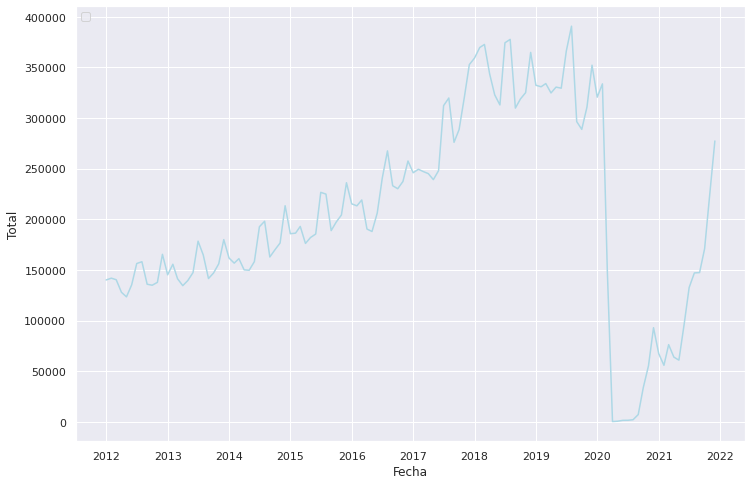

In [ ]:
import matplotlib.ticker as tick
sns.lineplot(data=Conteo, x="Fecha", y="Total",color="lightblue")
plt.ticklabel_format(style='plain', axis='y')
plt.legend(loc='upper left')

**¿QUE?:El usuario observa la cantidad de extranjeros que llegaron a Colombia.** 


**¿POR QUÉ?: La tarea que requiere el usuario es visualizar los flujos de inmigracion a Colombia. Después así pueda identificar en que año hubo una mayor cantidad de extranjeros en el país.**

## Horizon Chart

In [ ]:
area1 = alt.Chart(Conteo).mark_area(
    clip=True,
    interpolate='monotone',color="lightblue"
).encode(
    alt.X('Fecha:T', 
          scale=alt.Scale(zero=True, nice=True)),
    alt.Y('Total:Q', title='Valor')
).properties(
    width=500,
    height=300
)
area1

alt.Chart(...)

**¿QUE?:El usuario observa la cantidad de extranjeros que llegaron a Colombia.**

**¿POR QUÉ?: La tarea que requiere el usuario es visualizar los flujos de inmigracion a Colombia. Después así pueda identificar en que año hubo una mayor cantidad de extranjeros en el país.**

#Widgets

In [ ]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from ipywidgets import widgets

In [ ]:
month = widgets.IntSlider(
    value=1.0,
    min=1.0,
    max=12.0,
    step=1.0,
    description='Month:',
    continuous_update=False
)
month

IntSlider(value=1, continuous_update=False, description='Month:', max=12, min=1)

In [ ]:
use_date = widgets.Checkbox(
    description='Date: ',
    value=True,
)
use_date

Checkbox(value=True, description='Date: ')

In [ ]:
textbox = widgets.Dropdown(
    description='Ciudad:   ',
    value='Bogotá',
    options=df_extranjeros['Ciudad'].unique().tolist()
)
textbox

Dropdown(description='Ciudad:   ', options=('Bogotá', 'Leticia', 'Pasto', 'Cartagena', 'Soledad', 'Santa Marta…

In [ ]:
# widget que queremos aplicar

In [ ]:
CON = widgets.Dropdown(
    description='Continente:   ',
    value='América del Sur',
    options=df_extranjeros['Continente'].unique().tolist()
)
CON

Dropdown(description='Continente:   ', index=3, options=('EUROPA', 'AFRICA', 'América del Norte', 'América del…

In [ ]:
def validate():
    if CON.value in df_extranjeros['Continente'].unique() :
        return True
    else:
        return False

In [ ]:
def response(change):
    if validate():
            filter_list = [i for i in
                           zip(df_extranjeros['Continente'] == CON.value)]
            temp_df = df_extranjeros[filter_list]

In [ ]:
filter_list = [i for i in
                           zip(df_extranjeros['Continente'] == CON.value)]

In [ ]:
temp_df

NameError: ignored

In [ ]:
type(CON)

ipywidgets.widgets.widget_selection.Dropdown

In [ ]:
def response(change):
    if validate():
            filter_list = [i for i in
                           zip(df_extranjeros['Continente'] == CON.value]
            temp_df = df_extranjeros[filter_list]


        x1 = temp_df['Total']
        with area1.batch_update():
            area1.data[0].x = x1
            area1.layout.xaxis.title = 'Delay in Minutes'
            area1.layout.yaxis.title = 'Number of Delays'

SyntaxError: ignored

In [ ]:
CON.observe(response, names="value")

In [ ]:
container2 = widgets.HBox([CON])

## Grafico Radial

In [ ]:
mp2021=pd.pivot_table(df_extranjeros,columns="Año#",index="Mes#",values="Total",aggfunc= 'sum')
mp2021

Año#,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
Mes#,,,,,,,,,,
1,140182,145272,161909,185843,215327,246025,359251,332396,320626,67429
2,141963,155704,156800,186405,213365,249481,369649,330890,333755,55947
3,140409,141368,161232,193039,219143,247276,372663,334054,149853,76353
4,128041,134576,150163,176230,190442,245139,343529,324792,441,64041
5,123503,139609,149764,182073,188044,239240,322931,330566,745,61041
6,135385,147487,158289,185535,206193,248094,312969,329508,1617,96157
7,156415,178486,192717,226667,240713,312302,374313,366146,1675,132725
8,158186,164790,198148,224938,267583,319808,377674,390696,2202,147145
9,135990,141607,162871,188902,233188,276059,309844,296516,7297,147462


In [ ]:
from math import pi
# Datos
df = pd.DataFrame({
'group': ["2012","2013","2014","2015","2016",'2017','2018','2019','2020',"2021"],
'Enero': [140182,145272,161909,185843,215327,246025,359251,332396,320626,67429],
'Febrero': [141963,155704,156800,186405,213365,249481,369649,330890,333755,55947],
'Marzo': [140409,141368,161232,193039,219143,247276,372663,334054,149853,76353],
'Abril': [128041,134576,150163,176230,190442,245139,343529,324792,441,64041],
'Mayo': [123503,139609,149764,182073,188044,239240,322931,330566,745,61041],
'Junio': [135385,147487,158289,185535,206193,248094,312969,329508,1617,96157],
'Julio': [156415,178486,192717,226667,240713,312302,374313,366146,1675,132725],
'Agosto': [158186,164790,198148,224938,267583,319808,377674,390696,2202,147145],
'Septiembre': [135990,141607,162871,188902,233188,276059,309844,296516,7297,147462],
'Octubre': [134982,147031,169887,197339,230257,288539,318822,288839,33855,171016],
'Noviembre': [137814,156148,176674,204331,237399,320098,325101,310840,55407,225431],
'Diciembre': [165496,180020,213464,236161,257603,352755,364819,352203,93079,277379], 
})
df

,group,Enero,Febrero,Marzo,Abril,Mayo,Junio,Julio,Agosto,Septiembre,Octubre,Noviembre,Diciembre
0,2012,140182,141963,140409,128041,123503,135385,156415,158186,135990,134982,137814,165496
1,2013,145272,155704,141368,134576,139609,147487,178486,164790,141607,147031,156148,180020
2,2014,161909,156800,161232,150163,149764,158289,192717,198148,162871,169887,176674,213464
3,2015,185843,186405,193039,176230,182073,185535,226667,224938,188902,197339,204331,236161
4,2016,215327,213365,219143,190442,188044,206193,240713,267583,233188,230257,237399,257603
5,2017,246025,249481,247276,245139,239240,248094,312302,319808,276059,288539,320098,352755
6,2018,359251,369649,372663,343529,322931,312969,374313,377674,309844,318822,325101,364819
7,2019,332396,330890,334054,324792,330566,329508,366146,390696,296516,288839,310840,352203
8,2020,320626,333755,149853,441,745,1617,1675,2202,7297,33855,55407,93079
9,2021,67429,55947,76353,64041,61041,96157,132725,147145,147462,171016,225431,277379


In [ ]:
# Número de variables numéricas Mesee
categories=list(df)[1:]
N = len(categories)
print(categories)
print(N)

['Enero', 'Febrero', 'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre', 'Octubre', 'Noviembre', 'Diciembre']
12


## Dibujar el eje radial

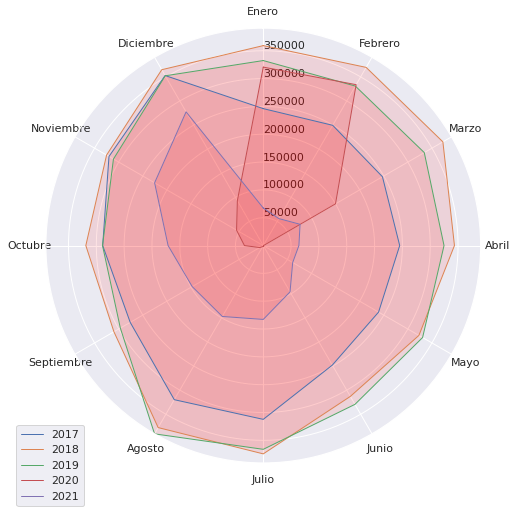

In [ ]:
maxnum = df[categories].values.max()
angles = [n / float(N) * 2 * pi for n in range(N)]
angles += angles[:1] 
ax = plt.subplot(111, polar=True) 
ax.set_theta_offset(pi / 2)
ax.set_theta_direction(-1)
plt.xticks(angles[:-1], categories)
ax.set_rlabel_position(0)
plt.ylim(0,maxnum)

# trabajamos con 5 años desde 2017 a 2021
 
 
# Año 2017
values=df.loc[5].drop('group').values.flatten().tolist()
values += values[:1]
ax.plot(angles, values, linewidth=1, linestyle='solid', label="2017")
ax.fill(angles, values, 'red', alpha=0.1)

# Año 2018
values=df.loc[6].drop('group').values.flatten().tolist()
values += values[:1]
ax.plot(angles, values, linewidth=1, linestyle='solid', label="2018")
ax.fill(angles, values, 'red', alpha=0.1)
 
# Año 2019
values=df.loc[7].drop('group').values.flatten().tolist()
values += values[:1]
ax.plot(angles, values, linewidth=1, linestyle='solid', label="2019")
ax.fill(angles, values, 'red', alpha=0.1)

# Año 2020
values=df.loc[8].drop('group').values.flatten().tolist()
values += values[:1]
ax.plot(angles, values, linewidth=1, linestyle='solid', label="2020")
ax.fill(angles, values, 'red', alpha=0.1)

# Año 2021
values=df.loc[9].drop('group').values.flatten().tolist()
values += values[:1]
ax.plot(angles, values, linewidth=1, linestyle='solid', label="2021")
ax.fill(angles, values, 'red', alpha=0.1)
 
# Agregar leyenda
plt.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1))

# TARAAAAN
plt.show()

**¿QUE?:El usuario observa la cantidad de extranjeros que llegaron a Colombia.** 

**¿POR QUÉ?: La tarea que requiere el usuario es visualizar los flujos de inmigracion a Colombia. Después así pueda identificar en que año hubo una mayor cantidad de extranjeros en el país.**

#Streamgraph

In [ ]:
Conteo_tipo_CON = pd.pivot_table(df_extranjeros, 
                                values='Total', 
                                index=['Fecha','Continente'],
                                #columns=['Tipo de Contrato'], 
                                aggfunc=np.count_nonzero)
Conteo_tipo_CON = pd.DataFrame(Conteo_tipo_CON)
Conteo_tipo_CON.reset_index(inplace=True)
Conteo_tipo_CON = Conteo_tipo_CON.rename(columns = {'index':'ID','CodigoProveedor':'Conteo'})
Conteo_tipo_CON.head()

,Fecha,Continente,Total
0,2012-01-01,AFRICA,47
1,2012-01-01,ASIA,111
2,2012-01-01,América Central,145
3,2012-01-01,América del Norte,68
4,2012-01-01,América del Sur,148


In [ ]:
alt.Chart(Conteo_tipo_CON).mark_area().encode(
    alt.X('Fecha:T'),
    alt.Y('Total:Q'),
    alt.Color('Continente:N',scale=alt.Scale(scheme='category20'))
).properties(
    width=800,
    height=600
)

alt.Chart(...)

**¿QUÉ?:El usuario observa la proporción de extranjeros que llegaron a Colombia.** 
 

**¿POR QUÉ?:La tarea que tiene el usuario, es de visualizar la proporción de extranjeros que llegaron a Colombia, para así identificar posibles tendencias de los continentes de donde provienen los extranjeros.** 

In [ ]:
alt.Chart(Conteo_tipo_CON).mark_area().encode(
    alt.X('Fecha:T',
        axis=alt.Axis(format='%Y-%m')
    ),
    alt.Y('sum(Total):Q', stack='center', axis=None),
    alt.Color('Continente:N',
        scale=alt.Scale(scheme='category20')
    )
).properties(
    width=800,
    height=600
)

alt.Chart(...)

**¿QUÉ?:El usuario observa la proporción de extranjeros que llegaron a Colombia.** 
 

**¿POR QUÉ?:La tarea que tiene el usuario, es de visualizar la proporción de extranjeros que llegaron a Colombia, para así identificar posibles tendencias de los continentes de donde provienen los extranjeros.** 

In [ ]:
alt.Chart(Conteo_tipo_CON).mark_area().encode(
    alt.X('Fecha:T',
        axis=alt.Axis(format='%Y-%m')
    ),
    alt.Y('sum(Total):Q', stack='normalize', axis=None),
    alt.Color('Continente:N',
        scale=alt.Scale(scheme='category20')
    )
).properties(
    width=800,
    height=600
)

alt.Chart(...)

**¿QUÉ?:El usuario observa la proporción de extranjeros que llegaron a Colombia.** 
 

**¿POR QUÉ?:La tarea que tiene el usuario, es de visualizar la proporción de extranjeros que llegaron a Colombia, para así identificar posibles tendencias de los continentes de donde provienen los extranjeros.** 

#Mapas

## Importar librerias

In [ ]:
!pip install --upgrade geopandas
!pip install --upgrade pyshp
!pip install --upgrade shapely
!pip install --upgrade descartes
!pip install --upgrade topojson
!pip install --upgrade plotly

     |████████████████████████████████| 1.0 MB 5.0 MB/s 
     |████████████████████████████████| 6.3 MB 44.6 MB/s 
     |████████████████████████████████| 16.7 MB 362 kB/s 
     |████████████████████████████████| 44 kB 1.5 MB/s 
     |████████████████████████████████| 78 kB 3.3 MB/s 
     |████████████████████████████████| 28.8 MB 1.3 MB/s 
  Attempting uninstall: plotly
    Found existing installation: plotly 5.5.0
    Uninstalling plotly-5.5.0:
      Successfully uninstalled plotly-5.5.0


In [ ]:
%matplotlib inline
import pandas as pd
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
import plotly.express as px

In [ ]:
?px.scatter_geo

In [ ]:
fig = px.scatter_geo(df_extranjeros, 
                     lat='Latitud',
                     lon='Longitud', 
                     hover_name="Ciudad", 
                     projection="equirectangular",
                     center = {"lat": 4.570868, "lon": -74.297333})
fig.update_layout(
        title_text = 'Destinos de extranjeros',
        showlegend = True,
        geo = dict(
            scope = 'south america',
            landcolor = 'rgb(217, 217, 217)',
        )
    )
fig.show()


**¿QUÉ?:El usuario observa los puntos donde la gran mayoría de extranjeros llegaron a Colombia.** 
 

**¿POR QUÉ?:La tarea del usuario, es visualizar cuáles fueron los puntos donde fue más frecuente la llegada de extranjeros, para así identificar qué ciudades de Colombia son las que reciben un mayor flujo de inmigración.** 

In [ ]:
#Bogotá,Medellin,Cúcuta,Cartagena,Pasto,Cali
df_extranjeros.Latitud[1]

'4.697144'

In [ ]:
len(df_extranjeros["Latitud"])

112293

In [ ]:
(df_extranjeros 
  .groupby("Longitud")
  .agg(frequency=("Longitud", "count")))

,frequency
Longitud,
-77.28111,8588
-76.5225,9055
-75.56359,11006
-75.51444,16627
-74.08175,17369
-72.50782,5759
-67.483929,591
-67.927521,228
-69.941278,3717


In [ ]:
#Longitudes

for i in range(112293):
  if df_extranjeros.Ciudad[i] == "Bogotá":
    df_extranjeros.Longitud[i] = -74.08175
  if df_extranjeros.Ciudad[i] == "Medellin":
    df_extranjeros.Longitud[i] = -75.56359
  if df_extranjeros.Ciudad[i] == "Cúcuta":
    df_extranjeros.Longitud[i] = -72.50782
  if df_extranjeros.Ciudad[i] == "Cartagena":
    df_extranjeros.Longitud[i] = -75.51444
  if df_extranjeros.Ciudad[i] == "Pasto":
    df_extranjeros.Longitud[i] = -77.28111
  if df_extranjeros.Ciudad[i] == "Cali":
    df_extranjeros.Longitud[i] = -76.5225

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: SettingWithCopyWarning:


A value is tryin

In [ ]:
#Latitudes
for i in range(112293):
  if df_extranjeros.Ciudad[i] == "Bogotá":
    df_extranjeros.Latitud[i] = 4.60971
  if df_extranjeros.Ciudad[i] == "Medellin":
    df_extranjeros.Latitud[i] = 6.25184
  if df_extranjeros.Ciudad[i] == "Cúcuta":
    df_extranjeros.Latitud[i] = 7.89391
  if df_extranjeros.Ciudad[i] == "Cartagena":
    df_extranjeros.Latitud[i] = 10.39972
  if df_extranjeros.Ciudad[i] == "Pasto":
    df_extranjeros.Latitud[i] = 1.21361
  if df_extranjeros.Ciudad[i] == "Cali":
    df_extranjeros.Latitud[i] = 3.43722
  
  
  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is tryin

In [ ]:
import plotly.graph_objects as go
px.set_mapbox_access_token("pk.eyJ1Ijoid2lsbGlhbS10YWxlcm8iLCJhIjoiY2wyM2xmZ3VoMXJncTNpcWRjM3A5ZW5rZCJ9.AA6seVi6IO3k1I334WHxvg")


In [ ]:
fig = px.scatter_mapbox(df_extranjeros,
                        lat='Latitud',
                        lon='Longitud',
                        hover_name='Ciudad',
                        zoom=4,
                        color="Ciudad",
                        size="Total",
                        animation_frame="Año", 
                        center = {"lat": 4.570868, "lon": -74.297333})
fig.update_layout(
        title_text = 'Cantidad de extranjeros por año en Colombia',
        showlegend = True,
        geo = dict(
            scope = 'south america',
            landcolor = 'rgb(217, 217, 217)',
        )
    )
fig.show()

**¿QUÉ?:El usuario observa los puntos donde la gran mayoría de extranjeros llegaron a Colombia.** 
 

**¿POR QUÉ?:La tarea del usuario, es visualizar cuáles fueron los puntos donde fue más frecuente la llegada de extranjeros, para así identificar qué ciudades de Colombia son las que reciben un mayor flujo de inmigración.** 

In [ ]:
# General

In [ ]:
fig = px.scatter_mapbox(df_extranjeros,
                        lat='Latitud',
                        lon='Longitud',
                        hover_name='Ciudad',
                        zoom=4,
                        color="Continente",
                        size="Total",
                        animation_frame="Año", 
                        center = {"lat": 4.570868, "lon": -74.297333}
                        )
fig.update_layout(
        title_text = 'Cantidad de extranjeros por año en Colombia',
        showlegend = True,
        geo = dict(
            scope = 'south america',
            landcolor = 'rgb(1000, 200, 3000)',
        )
    )
fig.show()

**¿QUÉ?:El usuario observa los puntos donde la gran mayoría de extranjeros llegaron a Colombia.** 

**¿POR QUÉ?:La tarea del usuario, es visualizar cuáles fueron los puntos donde fue más frecuente la llegada de extranjeros, para así identificar qué ciudades de Colombia son las que reciben un mayor flujo de inmigración.** 

In [ ]:
fig = px.scatter_mapbox(df_extranjeros,
                        lat='Latitud',
                        lon='Longitud',
                        hover_name='Ciudad',
                        zoom=4,
                        color="Continente",
                        size="Femenino",
                        animation_frame="Año", 
                        center = {"lat": 4.570868, "lon": -74.297333}
                        )
fig.update_layout(
        title_text = 'Cantidad de mujeres visitantes por año en Colombia',
        showlegend = True,
        geo = dict(
            scope = 'south america',
            landcolor = 'rgb(1000, 200, 3000)',
        )
    )
fig.show()

**¿QUÉ?:El usuario observa los puntos donde la gran mayoría de extranjeros llegaron a Colombia, pero ahora diferenciado por sexos.** 
 

**¿POR QUÉ?:La tarea del usuario, es visualizar cuáles fueron los puntos donde fue más frecuente la llegada de extranjeros, para así identificar qué ciudades de Colombia son las que reciben un mayor flujo de inmigración por sexos.**

In [ ]:
fig = px.scatter_mapbox(df_extranjeros,
                        lat='Latitud',
                        lon='Longitud',
                        hover_name='Ciudad',
                        zoom=4,
                        color="Continente",
                        size="Masculino",
                        animation_frame="Año", 
                        center = {"lat": 4.570868, "lon": -74.297333}
                        )
fig.update_layout(
        title_text = 'Cantidad de mujeres visitantes por año en Colombia',
        showlegend = True,
        geo = dict(
            scope = 'south america',
            landcolor = 'rgb(1000, 200, 3000)',
        )
    )
fig.show()

**¿QUÉ?:El usuario observa los puntos donde la gran mayoría de extranjeros llegaron a Colombia, pero ahora diferenciado por sexos.**

**¿POR QUÉ?:La tarea del usuario, es visualizar cuáles fueron los puntos donde fue más frecuente la llegada de extranjeros, para así identificar qué ciudades de Colombia son las que reciben un mayor flujo de inmigración por sexos.**


# Graficos con filtros

In [5]:
import pandas as pd
import plotly.express as px 

In [6]:
fig = px.bar(df_extranjeros, x="Continente", y="Total", color="Continente",
   animation_frame="Año",  
   range_y=[0,1100000])
fig.update_layout(
    height=600,
    title_text='hola bb'
)
fig.show()

In [117]:
df2021=df_extranjeros[df_extranjeros['Año'] == 2021]
df2020=df_extranjeros[df_extranjeros['Año'] == 2020]
df2019=df_extranjeros[df_extranjeros['Año'] == 2019]
df2018=df_extranjeros[df_extranjeros['Año'] == 2018]
df2017=df_extranjeros[df_extranjeros['Año'] == 2017]
df2016=df_extranjeros[df_extranjeros['Año'] == 2016]
df2015=df_extranjeros[df_extranjeros['Año'] == 2015]
df2014=df_extranjeros[df_extranjeros['Año'] == 2014]
df2013=df_extranjeros[df_extranjeros['Año'] == 2013]
df2012=df_extranjeros[df_extranjeros['Año'] == 2012]

In [42]:
tab1 = df2021.groupby('Continente').sum()["Total"].values;tab1


array([  1747,  28154, 140508, 623274, 514882,      2,    758, 210232,
         2569])

In [58]:
tab2=df2020.groupby('Continente').sum()["Total"].values;tab2

array([  1302,  17784,  75346, 313195, 422388,    689, 165669,   4179])

In [32]:
tab3=df2019.groupby('Continente').sum()["Total"].values;tab3

array([   5000,   75320,  280512,  984825, 1983449,    3442,  634331,
         20535,      32])

In [100]:
tab4=df2018.groupby('Continente').sum()["Total"].values;tab4

array([   4283,   73109,  270833,  901578, 2289674,    3096,  587953,
         20898,     141])

In [120]:
tab6=df2016.groupby('Continente').sum()["Total"].values;tab6

array([   4529,   65075,  225267,  710476, 1195163,       1,    2585,
        477412,   18740,       9])

In [118]:
tab5=df2017.groupby('Continente').sum()["Total"].values;tab5
tab6=df2016.groupby('Continente').sum()["Total"].values;tab6
tab7=df2015.groupby('Continente').sum()["Total"].values;tab7
tab8=df2014.groupby('Continente').sum()["Total"].values;tab8
tab9=df2013.groupby('Continente').sum()["Total"].values;tab9
tab10=df2012.groupby('Continente').sum()["Total"].values;tab8

array([  4042,  49130, 130327, 534787, 934791,   1752, 381661,  15428])

In [121]:
a = pd.DataFrame();a["CON"]=np.array(tab1)
b = pd.DataFrame();b["CON"]=np.array(tab2)
c = pd.DataFrame();c["CON"]=np.array(tab3)
d = pd.DataFrame();d["CON"]=np.array(tab4)
e = pd.DataFrame();e["CON"]=np.array(tab5)
f = pd.DataFrame();f["CON"]=np.array(tab6)
g = pd.DataFrame();g["CON"]=np.array(tab7)
h = pd.DataFrame();h["CON"]=np.array(tab8)
i = pd.DataFrame();i["CON"]=np.array(tab9)
j = pd.DataFrame();j["CON"]=np.array(tab10)

In [126]:
a["Año"]=[2021,2021,2021,2021,2021,2021,2021,2021,2021]
b["Año"]=[2020,2020,2020,2020,2020,2020,2020,2020]
c["Año"]=[2019,2019,2019,2019,2019,2019,2019,2019,2019]
d["Año"]=[2018,2018,2018,2018,2018,2018,2018,2018,2018]
e["Año"]=[2017,2017,2017,2017,2017,2017,2017,2017,2017]
f["Año"]=[2016,2016,2016,2016,2016,2016,2016,2016,2016,2016]
g["Año"]=[2015,2015,2015,2015,2015,2015,2015,2015]
h["Año"]=[2014,2014,2014,2014,2014,2014,2014,2014]
i["Año"]=[2013,2013,2013,2013,2013,2013,2013,2013,2013]
j["Año"]=[2012,2012,2012,2012,2012,2012,2012,2012,2012]

In [127]:
df_extranjeros_f = pd.concat([j,i,h,g,f,e,d,c,b,a], axis=0)

In [129]:
df_extranjeros_f

,CON,Año
0,2950,2012
1,41992,2012
2,103557,2012
3,458215,2012
4,753459,2012
...,...,...
4,514882,2021
5,2,2021
6,758,2021
7,210232,2021


In [136]:
df2012.groupby('Continente').sum()["Total"]

Continente
AFRICA                 2950
ASIA                  41992
América Central      103557
América del Norte    458215
América del Sur      753459
Antartida                76
Desconocido               9
EUROPA               325050
OCEANIA               13058
Name: Total, dtype: int64

In [138]:
df_extranjeros_f["Origen"]=["Africa","Asia","América Central","América del Norte","América del Sur","Antartida","Desconocido","Europa","Oceania",
                            "Africa","Asia","América Central","América del Norte","América del Sur","Antartida","Desconocido","Europa","Oceania"
                            ,"Africa","Asia","América Central","América del Norte","América del Sur","Desconocido","Europa","Oceania"
                            ,"Africa","Asia","América Central","América del Norte","América del Sur","Desconocido","Europa","Oceania",
                            "Africa","Asia","América Central","América del Norte","América del Sur","Antartida","Desconocido","Europa","Oceania","Refugiado"
                            ,"Africa","Asia","América Central","América del Norte","América del Sur","Desconocido","Europa","Oceania","Refugiado",
                            "Africa","Asia","América Central","América del Norte","América del Sur","Desconocido","Europa","Oceania","Refugiado",
                          "Africa","Asia","América Central","América del Norte","América del Sur","Desconocido","Europa","Oceania","Refugiado",
                          "Africa","Asia","América Central","América del Norte","América del Sur","Desconocido","Europa","Oceania",
                          "Africa","Asia","América Central","América del Norte","América del Sur","Antartida","Desconocido","Europa","Oceania"]

In [169]:
fig = px.bar(df_extranjeros_f, x="CON", y="Origen", color="Origen",
   animation_frame="Año",
   range_x=[0,1100000])
fig.update_layout(
    height=600,
    title_text='Cantidad de extranjeros por continente 2012-2021'
)
fig.show()

In [ ]:
category_orders={'Origen': ['América del Sur',"América del Norte","Europa","America Central","Asia","Oceania","Africa","Desconocido","Refugiado","Antartida"

**¿QUÉ?:El usuario observa la cantidad de extranjeros que llegaron a Colombia por continente del año 2012 a 2021.** 

**¿POR QUÉ?:La tarea que tiene el usuario, es de visualizar la cantidad de extranjeros que llegaron a Colombia, para así identificar posibles tendencias de los continentes de donde provienen los extranjeros.** 

In [142]:
fig.update_layout(
    height=600,
    title_text='Cantidad de extranjeros por continente 2012-2021'
)

**¿QUÉ?:El usuario observa la cantidad de extranjeros que llegaron a Colombia por continente del año 2012 a 2021.** 

**¿POR QUÉ?:La tarea que tiene el usuario, es de visualizar la cantidad de extranjeros que llegaron a Colombia, para así identificar posibles tendencias de los continentes de donde provienen los extranjeros.** 

# Ciudades a las que mas llegan

In [167]:
fig = px.bar(df_extranjeros, x="Total", y="Ciudad", color="Ciudad",
   animation_frame="Año", orientation='h',  
   range_x=[0,200000])
fig.update_layout(
    height=600,
    title_text='Ciudades de colombia por cantidad de extranjeros que reciben por año'
)
fig.show()